**Выполнил:** Панов Алексей

# **Домашнее задание #3. Шагающие человечки**

## **Часть 0. Вспоминаем код архитектуры и проверяем работоспособность детектора**

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
import os
import time
import glob
import random
import torch
import torchvision
import torch.optim
# import torch.utils.data

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg
import torch.nn.functional as F
import torch.backends.cudnn as cudnn

from math import sqrt
from sklearn.metrics import auc
from torch import nn
from torchvision import transforms
from PIL import Image, ImageDraw, ImageFont
from torch.utils.data import Dataset, DataLoader

import warnings
warnings.filterwarnings('ignore')

In [ ]:
torch.__version__

'1.10.0+cu111'

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
GDISK_MOUNT_DIR = '/content/gdrive'
GDISK_WORK_DIR = 'MyDrive/Colab Notebooks/ml3/hw/3'
GDISK_DIR = os.path.join(GDISK_MOUNT_DIR, GDISK_WORK_DIR)
DATASET = 'PennFudanPed.zip'

In [ ]:
from google.colab import drive
drive.mount(GDISK_MOUNT_DIR, force_remount=True)

Mounted at /content/gdrive


In [ ]:
!cp -a '{GDISK_DIR}/.' '.'
!unzip -q '{DATASET}' -d '.'

In [ ]:
# в данную библиотеку перенесена вся неизменяемая часть (исходная реализация SSD и др.)
from ssdlib.ssd import SSD300, MultiBoxLoss, find_jaccard_overlap
# здесь собраны все необходимые трансформации для обучения и теста.
# базовые идеи позаимствованы из https://github.com/amdegroot/ssd.pytorch,
# но в целом все сделано на свой лад
import ssdlib.transforms as tf

In [ ]:
# будем использовать модель предобученную на Pascal VOC, вот его классы
voc_labels = ('background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable',
              'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor')

label_map = {k: v for v, k in enumerate(voc_labels)}
rev_label_map = {v: k for k, v in label_map.items()} 

# Color map for bounding boxes of detected objects from https://sashat.me/2017/01/11/list-of-20-simple-distinct-colors/
distinct_colors = ['#e6194b', '#3cb44b', '#ffe119', '#0082c8', '#f58231', '#911eb4', '#46f0f0', '#f032e6',
                   '#d2f53c', '#fabebe', '#008080', '#000080', '#aa6e28', '#fffac8', '#800000', '#aaffc3', '#808000',
                   '#ffd8b1', '#e6beff', '#808080', '#FFFFFF']
label_color_map = {k: distinct_colors[i] for i, k in enumerate(label_map.keys())}

### **Задание 0** (1 балл) 

[Скачайте](https://drive.google.com/file/d/1ySBa0zbcd-59zan-8c0gwbmywd8dEq5h/view?usp=sharing) обученные на `Pascal VOC` веса для этой модели. Положите их себе на drive.

Подгрузите веса и протестите ssd на [одной из картинок](https://www.google.com/url?sa=i&url=https%3A%2F%2Fvk.com%2F%40shizpub-ochen-dovolnyi-pesel&psig=AOvVaw0ef1A0Qgda7GjhW3d9Fs-w&ust=1635250162815000&source=images&cd=vfe&ved=0CAsQjRxqFwoTCMiZmt_D5fMCFQAAAAAdAAAAABAE) (мы же хотим убедиться что с весами всё ок).

In [ ]:
ssd = SSD300(n_classes=21)
ssd.to(device)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]


 Loaded backbone.



SSD300(
  (base): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), 

In [ ]:
# указываем путь к данным
data_path = '.'
checkpoint_name = 'checkpoint_ssd300_pascal_voc.pth'
checkpoint = torch.load(os.path.join(data_path, checkpoint_name), map_location=torch.device(device))

In [ ]:
# загружаем веса
ssd.load_state_dict(checkpoint['state_dict'])

<All keys matched successfully>

In [ ]:
# вот из таких частей должен будет состоять будущий трансформ
dataset_mean = [0.485, 0.456, 0.406]
dataset_std = [0.229, 0.224, 0.225]

transform_for_test = transforms.Compose(
    [   
        transforms.Resize((300, 300)),
        transforms.ToTensor(),
        transforms.Normalize(mean=dataset_mean, std=dataset_std)
    ])

In [ ]:
# тут считайте картинку с помощью PIL и подготовьте к подаче в детектор
image_path = os.path.join(data_path, 'test_images/ej5UPl0A72A.jpg')
original_image = Image.open(image_path).convert('RGB')
# применяем к изображению выбранное преобразование
img = transform_for_test(original_image).to(device)

In [ ]:
# получите предсказания детектора и используйте ssd.detect_objects(), чтобы получить финальные боксы, 
# для ssd порог на скор приемлемо брать в диапазоне 0.5-0.7, порог для nms в диапазоне 0.3-0.5
min_score = 0.7
max_overlap = 0.5
top_k = 100

with torch.no_grad():
    locs, scores = ssd(img.unsqueeze(0))
    det_boxes, det_labels, det_scores = ssd.detect_objects(locs, scores, min_score, max_overlap, top_k)

In [ ]:
# нам надо полученные относительные боксы накинуть на первоначальный размер изображения
det_boxes = det_boxes[0] * torch.FloatTensor(original_image.size * 2).to(device)
det_labels = [rev_label_map[l] for l in det_labels[0].to('cpu').tolist()]

In [ ]:
# функция для рисования
def draw_boxes(original_image, det_boxes, det_labels):
    annotated_image = original_image.copy()
    draw = ImageDraw.Draw(annotated_image)
    font = ImageFont.load_default()

    for i in range(det_boxes.size(0)):
        # Boxes
        box_location = det_boxes[i].tolist()
        draw.rectangle(xy=box_location, outline=label_color_map[det_labels[i]])
        draw.rectangle(xy=[l + 1. for l in box_location], outline=label_color_map[det_labels[i]]) 
        # Text
        text_size = font.getsize(det_labels[i].upper())
        text_location = [box_location[0] + 2., box_location[1] - text_size[1]]
        textbox_location = [box_location[0], box_location[1] - text_size[1], box_location[0] + text_size[0] + 4., box_location[1]]
        draw.rectangle(xy=textbox_location, fill=label_color_map[det_labels[i]])
        draw.text(xy=text_location, text=det_labels[i].upper(), fill='white', font=font)

    return annotated_image

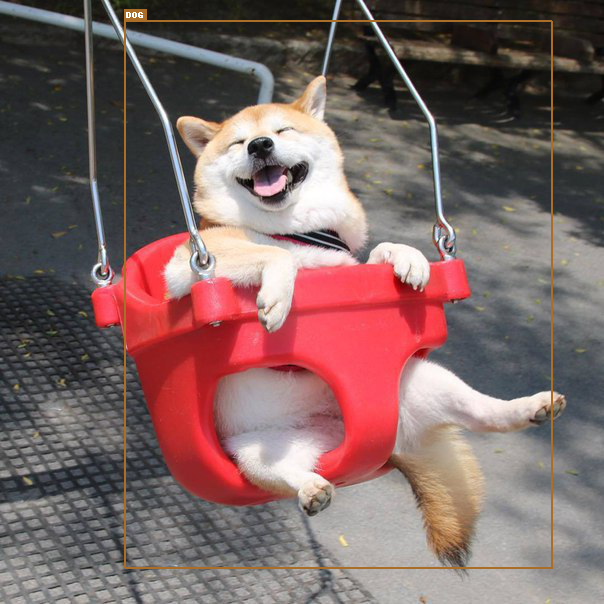

In [ ]:
draw_boxes(original_image, det_boxes, det_labels)

Попробуйте поиграться с гиперпараметрами чтобы получилось лучшее качаство на этой картинке. 

В целом результат не слишком великолепен - обучен детектор на небольшой базе `Pascal VOC`, мы используем не самую сильную его версию - `ssd300`, но даже с такими вводными у нас получится сделать интересное, let's get it started. 

## **Часть 1. Копаемся в данных**

На этот раз  у нас будет небольшой датасет из гуляющих людей (вы удивитесь насколько небольшой). Данные можно скачать [здесь](https://drive.google.com/file/d/1_8mnenRzV6ylr7L29LuhQHKd82GNzU9y/view?usp=sharing).

Для того, чтобы учить сеть, нужен будет `Dataloader`, а значит и собственный `Dataset`. Чтобы собрать `Dataset`, надо понять как выглядят данные и аннотация, а также какие данные понадобятся вашей сетке для обучения. Данные будут не совсем типичные для задачи - у вас будут картинки и маски объектов, из масок вам самим придется сделать боксы, которые так жаждет наш `MultiBoxLoss`.

Данные уже разделены на `train` и `test`, никакого кровосмешения больше не делаем.

**Нужно, чтобы данные лежали у вас архивом на Гуглдиске, тогда, поменяв директорию, ваши результаты я смогу воспроизвести и оценить.**

**NB**. Часть с копанием в данных приносит вам баллы, только если далее вы попробуете что-то осмысленное сделать с сеткой. 











### **Задание 1** (1 балл)
Разархивируйте данные, загрузите и посмотрите на фото и соответствующие им маски (соответствие происходит явно по имени), напишите функцию, которая по маске высчитывает бокс, отрисуйте 4-5 фото с полученными боксами. Эту функцию будем использовать в `Dataset`.

In [ ]:
train_images_path = os.path.join(data_path, 'PennFudanPed/Images/train')
train_masks_path = os.path.join(data_path, 'PennFudanPed/Masks/train')
test_images_path = os.path.join(data_path, 'PennFudanPed/Images/test')
test_masks_path = os.path.join(data_path, 'PennFudanPed/Masks/test')

In [ ]:
img_list = sorted(glob.glob(f'{train_images_path}/*'))
mask_list = sorted(glob.glob(f'{train_masks_path}/*'))

In [ ]:
def get_boxes(mask, normalize=False):
    '''
    Возвращает тензор с координатами боксов для каждой маски в формате
    [[x_min_1, y_min_1, x_max_1, y_max_1],
     ...
     [x_min_k, y_min_k, x_max_k, y_max_k]],
    где k - количество уникальных масок
    
    mask - двумерный numpy массив с масками
    normalize - нормировать размеры боксов на размер картинки
    '''
    mask_codes = np.unique(mask)
    boxes = []
    for code in mask_codes:
        if code != 0:
            mask_single = mask.copy()
            mask_single[mask_single != code] = 0
            x_min = np.where(mask_single.sum(axis=0) != 0)[0].min()
            x_max = np.where(mask_single.sum(axis=0) != 0)[0].max()
            y_min = np.where(mask_single.sum(axis=1) != 0)[0].min()
            y_max = np.where(mask_single.sum(axis=1) != 0)[0].max()
            boxes.append([x_min, y_min, x_max, y_max])
    boxes = torch.tensor(boxes)
    
    if normalize:
        boxes = boxes.type(torch.DoubleTensor)
        h_mask, w_mask = mask.shape
        boxes[:, 0::2] = boxes[:, 0::2] / w_mask
        boxes[:, 1::2] = boxes[:, 1::2] / h_mask
    
    return boxes

In [ ]:
np.random.seed(41)
indicies = np.random.choice(len(img_list), size=5, replace=False,)
ann_images = []
for idx in indicies:
    np_mask = mpimg.imread(mask_list[idx])
    original_image = Image.open(img_list[idx]).convert('RGB')
    det_boxes = get_boxes(np_mask)
    det_labels = ['person'] * det_boxes.shape[0]
    ann_images.append(draw_boxes(original_image, det_boxes, det_labels))

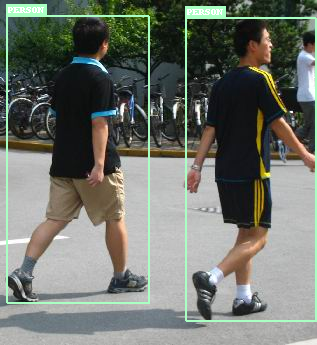

In [ ]:
ann_images[0]

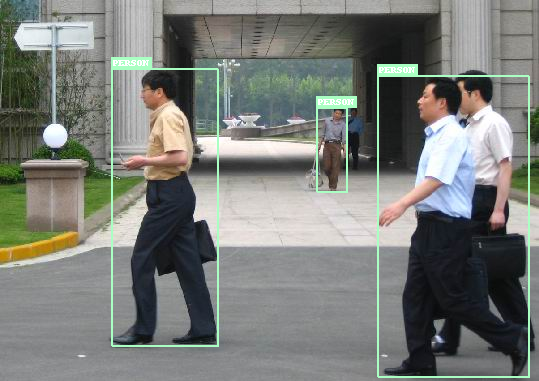

In [ ]:
ann_images[1]

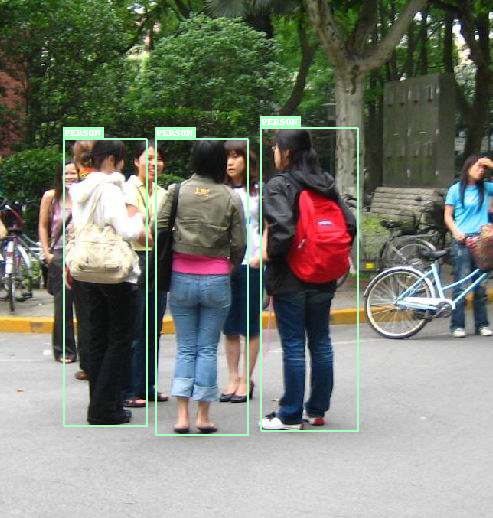

In [ ]:
ann_images[2]

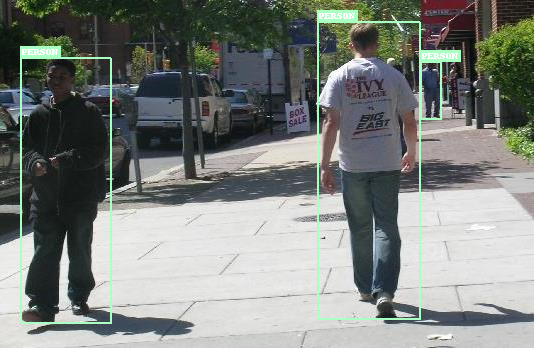

In [ ]:
ann_images[3]

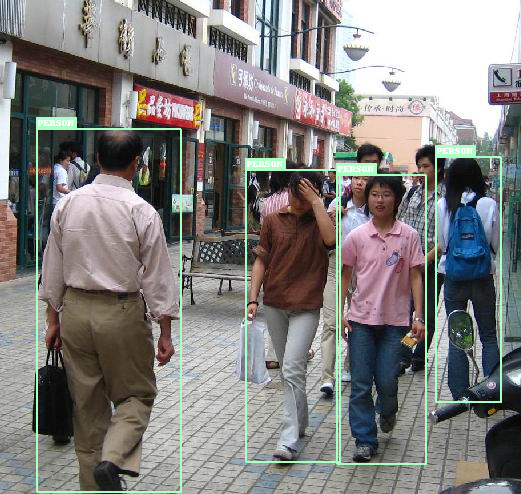

In [ ]:
ann_images[4]

### **Задание 2** (2 балла)

Посмотрите, в каком виде данные нужны будут детектору и лоссу для работы. Напишите `Dataset`, заведите по нему loader-ы для трейна и теста, проверьте что всё ок.

In [ ]:
# Заготовка датасета, можете менять её как удобно, главное чтобы работало
# hint: вероятно, вам понадобится функция collate_fn

class PedestrianSet(object):
    def __init__(self, root, transforms, target_label, is_train=False):
        self.root = root
        self.transforms = transforms
        self.target_label = target_label
        self.is_train = is_train
        subset = 'train' if self.is_train else 'test'
        # у нас нет аннотации, список картинок и масок надо подтянуть из root
        self.imgs = sorted(glob.glob(f'{root}/Images/{subset}/*'))
        self.masks = sorted(glob.glob(f'{root}/Masks/{subset}/*'))

    def __getitem__(self, idx):
        img_path = self.imgs[idx]
        # считываем картинку и маску с помощью PIL
        img = Image.open(img_path).convert('RGB')
        mask = mpimg.imread(self.masks[idx])
        boxes = get_boxes(mask, normalize=True)
        # хоть класс в данных всего один, надо верно выставить label на основании pascal voc 
        labels = torch.tensor([self.target_label] * boxes.shape[0])

        if self.transforms is not None:
            img, boxes = self.transforms(img, boxes)
        
        return img, boxes, labels, img_path

    def __len__(self):
        return len(self.imgs)

In [ ]:
# преобразования для теста
test_transform = tf.Compose(
    [   
        tf.Resize(shape=(300, 300)),
        tf.ToTensor(),
        tf.Normalize(mean=dataset_mean,
                     std=dataset_std)
    ])
# преобразования для трейна (базовый вариант без аугментаций)
train_transform = tf.Compose(
    [   
        tf.Resize(shape=(300, 300)),
        tf.ToTensor(),
        tf.Normalize(mean=dataset_mean,
                     std=dataset_std)
    ])

In [ ]:
def collate(batch):
    images, boxes, labels, image_paths = zip(*batch)
    images = torch.stack(images, dim=0)
    boxes = list(boxes)
    labels = list(labels)
    image_paths = list(image_paths)
    return images, boxes, labels, image_paths

In [ ]:
dataset_path = os.path.join(data_path, 'PennFudanPed')
# датасеты
test_dataset = PedestrianSet(dataset_path, transforms=test_transform,
                             target_label=label_map['person'], is_train=False)
train_dataset = PedestrianSet(dataset_path, transforms=train_transform,
                              target_label=label_map['person'], is_train=True)
# даталоадеры
test_dataloader = DataLoader(test_dataset, batch_size=12, num_workers=0, shuffle=False, collate_fn=collate)
train_dataloader = DataLoader(train_dataset, batch_size=12, num_workers=0, shuffle=True, collate_fn=collate)

In [ ]:
batch = next(iter(test_dataloader))

In [ ]:
# картинки
batch[0].shape

torch.Size([12, 3, 300, 300])

In [ ]:
# боксы
batch[1]

In [ ]:
# классы
batch[2]

In [ ]:
# пути к картинкам
batch[3]

## **Часть 2. Копаемся в SSD**

Глобальная идея - мы хотим проверить следующую гипотезу: если взять предобученный детектор, оставить ему одну голову только на один класс и затюнить его на моноклассовый датасет, то на тесте этого датасета мы получим лучше результат, чем на нем давал этот детектор первоначально. 

### **Задание 3**. (4 балла) 

Тогда сперва давайте получим результат детекции для класса `person` у первоначальной сети (никак не измененной) на `pedestrian test` сете. 

Что для этого нужно: 
 - получить предсказания детектора на всех фотках теста (1 балл)
 - написать функцию для подсчета `AP` (2 балла)
 - посчитать `АР` для класса `person` при `IoU=0.75` с gt (1 балл)

Ещё раз почитать про AP [тут](https://medium.com/@jonathan_hui/map-mean-average-precision-for-object-detection-45c121a31173) или на русском то же самое [тут](https://ml.i-neti.com/2019/07/05/russkiy-map-mean-average-precision-v-detektsii-obektov/).

Сразу скажу, что можно использовать код из [pycocotools](https://github.com/cocodataset/cocoapi/tree/master/PythonAPI/pycocotools), но не втупую. Возьмите оттуда только нужные для нашей задачи части. Во многих репозиториях вы увидите, что процедуры написаны специально для [coco](https://cocodataset.org/#home) - просто потому что это самый популярный датасет для детектирования и сегментации.

In [ ]:
# инференс модели на фотках из тестлоадера

with torch.no_grad():
    
    all_images = list()
    all_true_boxes = list()
    all_true_labels = list()
    all_image_paths = list()
    all_locs = list()
    all_scores = list()
    
    for images, boxes, labels, paths in test_dataloader:
        images = images.to(device)
        locs, scores = ssd(images)
        
        all_images.append(images)
        all_locs.append(locs)
        all_scores.append(scores)
        all_true_boxes.extend(boxes)
        all_true_labels.extend(labels)
        all_image_paths.extend(paths)
    
    all_images = torch.cat(all_images, dim=0).to(device)
    all_locs = torch.cat(all_locs, dim=0).to(device)
    all_scores = torch.cat(all_scores, dim=0).to(device)

In [ ]:
# параметры для фильтрации предиктов
min_score = 0.7
max_overlap = 0.5
top_k = 100
# получаем отфильтрованные предикты для всего тестового датасета
all_det_boxes, all_det_labels, all_det_scores = ssd.detect_objects(all_locs, all_scores, min_score, max_overlap, top_k)

Далее функции для расчета AP

In [ ]:
def filter_for_AP(all_det_boxes, all_det_labels, all_det_scores,
                  all_true_boxes, all_true_labels, target_label):
    '''
    Извлекает и возвращает данные только для target_label
    '''
    # all_det_boxes - список детекций для различных картинок.
    # объединим список в единый тензор и сделаем вспомогательный
    # массив маппинга в номера картинок
    det_map_to_images = torch.tensor(sum([[i] * length for i, length in enumerate(map(len, all_det_boxes))],
                                         [])).to(device)
    # объединяем все детекции
    det_boxes = torch.cat(all_det_boxes).to(device)
    det_labels = torch.cat(all_det_labels).to(device)
    det_scores = torch.cat(all_det_scores).to(device)
    # фильтруем детекции по target_label
    flt_target_label = (det_labels == target_label)
    det_boxes = det_boxes[flt_target_label]
    det_scores = det_scores[flt_target_label]
    det_map_to_images = det_map_to_images[flt_target_label]
    # фильтруем all_true_boxes по target_label
    true_boxes = [boxes[labels == target_label].to(device) for labels, boxes in zip(all_true_labels, all_true_boxes)]
    
    return det_boxes, det_scores, det_map_to_images, true_boxes

In [ ]:
def check_detections(det_boxes, det_scores, det_map_to_images, true_boxes,
                     iou_threshold):
    '''
    Проверяет корректность детекций.
    Предполагается, что все входные данные соответствуют какому-то конкретному классу (label).
    Возвращает массив ответов для каждой детекции: если "1", то детекция верная, иначе - ложная.
    '''
    # запоминаем общее количество детекций
    n_detections = len(det_boxes)
    # сортируем детекции по скору
    det_sort_scores, det_sort_indicies = det_scores.sort(descending=True)
    det_boxes = det_boxes[det_sort_indicies]
    det_map_to_images = det_map_to_images[det_sort_indicies]
    # формируем массивы TP и FP для дальшейшего вычисления  AP
    tp = np.zeros(n_detections, dtype=int)
    fp = np.zeros(n_detections, dtype=int)

    # флаги того, что истинные объекты уже были задетектированы
    object_detected = [[False] * length for length in map(len, true_boxes)]
    
    for i in range(n_detections):
        image_idx = det_map_to_images[i]
        if len(true_boxes[image_idx]) > 0:
            iou = find_jaccard_overlap(det_boxes[i].unsqueeze(0).to(device), true_boxes[image_idx].to(device))
            max_iou, max_iou_idx = torch.max(iou.squeeze(0), dim=0)
            if max_iou < iou_threshold:
                # слишком малое пересечение - FP
                fp[i] = 1
            else:
                if object_detected[image_idx][max_iou_idx]:
                    # объект уже был обнаружен ранее - FP
                    fp[i] = 1
                else:
                    # если же все ок, то имеем TP
                    object_detected[image_idx][max_iou_idx] = True
                    tp[i] = 1
        else:
            # объекта данного класса нет в gt разметке - FP
            fp[i] = 1
    
    return tp

In [ ]:
def calculate_AP(all_det_boxes, all_det_labels, all_det_scores,
                 all_true_boxes, all_true_labels, target_label,
                 iou_threshold, interpolate=False):
    '''
    Считает AP для заданного класса (target_label).
    Возвращает значение AP и массивы recall, precision для построения PR кривой.
    Флаг interpolate позволяет выбрать интерполированную AP вместо обычной.
    '''
    # выбираем только детекции, соответствующие заданному классу (target_label)
    det_boxes, det_scores, det_map_to_images, true_boxes = filter_for_AP(all_det_boxes,
                                                                         all_det_labels,
                                                                         all_det_scores,
                                                                         all_true_boxes,
                                                                         all_true_labels,
                                                                         target_label)
    # считаем общее количество объектов данного класса в gt разметке
    n_objects = sum(map(len, true_boxes))
    # считаем массив корректности детекций
    tp = check_detections(det_boxes, det_scores, det_map_to_images,
                          true_boxes, iou_threshold)
    
    cum_tp = np.cumsum(tp)
    cum_fp = np.cumsum(tp ^ 1)
    precision = np.concatenate(([1], cum_tp / (cum_tp + cum_fp)))
    recall = np.concatenate(([0], cum_tp / n_objects))

    if interpolate:
        precision = np.maximum.accumulate(precision[::-1])[::-1]
    ap = auc(recall, precision)
    
    return ap, recall, precision

In [ ]:
# функция для построения PR кривой
def plot_pr_curve(original_pr, interpolated_pr=None, label=None):
    fig, ax = plt.subplots(figsize=(7, 7))
    
    x1, y1 = original_pr
    ap = auc(x1, y1)
    ax.plot(x1, y1, label=f'original (AP = {ap:.3f})')
    
    if interpolated_pr is not None:
        x2, y2 = interpolated_pr
        i_ap = auc(x2, y2)
        ax.plot(x2, y2, label=f'interpolated (AP = {i_ap:.3f})')
    
    ax.set_title("PR curve", fontsize=16)
    ax.set_xlabel("recall", fontsize=14)
    ax.set_ylabel("precision", fontsize=14)
    ax.legend(fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1.1)
    ax.grid(linestyle='--')

In [ ]:
# считаем AP и interpolated AP
target_label = label_map['person']
iou_threshold = 0.75

ap, recall, precision = calculate_AP(all_det_boxes, all_det_labels, all_det_scores,
                                     all_true_boxes, all_true_labels,
                                     target_label=target_label, iou_threshold=iou_threshold)

i_ap, i_recall, i_precision = calculate_AP(all_det_boxes, all_det_labels, all_det_scores,
                                           all_true_boxes, all_true_labels,
                                           target_label=target_label, iou_threshold=iou_threshold,
                                           interpolate=True)

print(f'AP = {ap:.3f}')
print(f'interpolated AP = {i_ap:.3f}')

AP = 0.745
interpolated AP = 0.746


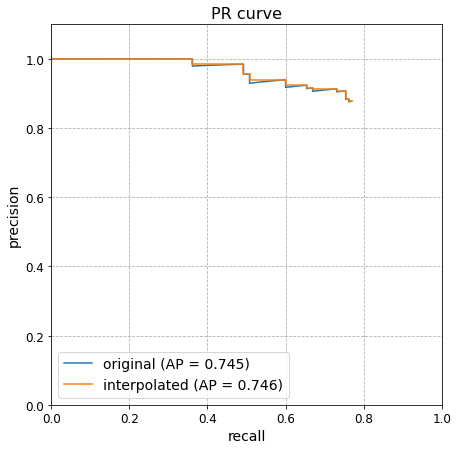

In [ ]:
# строим график
plot_pr_curve(original_pr=(recall, precision), interpolated_pr=(i_recall, i_precision))

Бонус: посмотрим, как предикты согласуются с gt

In [ ]:
# функция для отрисовки картинок с gt и det_boxes
def plot_images(images, filenames, det_boxes=None, det_labels=None, true_boxes=None,
                max_qty=None, total_width=16, n_cols=3, denorm_params=None):
    if max_qty is not None:
        n_total = min(len(images), max_qty)
    else:
        n_total = len(images)
        
    n_rows = int(np.ceil(n_total / n_cols))
    labels = [os.path.basename(filename) for filename in filenames]
    
    f, axarr = plt.subplots(nrows=n_rows, ncols=n_cols,
                            figsize=(total_width, total_width / n_cols * n_rows), squeeze=False)
    for i in range(n_rows):
        for j in range(n_cols):
            image_idx = i * n_cols + j
            if image_idx < n_total:
                img = images[image_idx]
                
                if denorm_params != None:
                    mean, std = denorm_params
                    # умножаем на std, прибавляем mean (в Normalize всё наоборот)
                    img = img * np.array(std) + np.array(mean)
                
                img = (img * 255).astype(np.uint8)
                axarr[i][j].imshow(img)
                
                if true_boxes is not None:
                    for box in true_boxes[image_idx]:
                        x_min, y_min, x_max, y_max = list(box * 300)
                        w = x_max - x_min
                        h = y_max - y_min
                        
                        box_rect = patches.Rectangle((x_min, y_min), w, h, lw=1, ls='--', ec='tab:orange',
                                                     facecolor='tab:orange', alpha=0.4)
                        axarr[i][j].add_patch(box_rect)
                
                if det_boxes is not None:
                    for box, label in zip(det_boxes[image_idx], det_labels[image_idx]):
                        x_min, y_min, x_max, y_max = list(box * 300)
                        w = x_max - x_min
                        h = y_max - y_min
                        str_label = rev_label_map[int(label)]
                        
                        box_rect = patches.Rectangle((x_min, y_min), w, h, linewidth=2,
                                                     edgecolor=label_color_map[str_label], facecolor='none')
                        axarr[i][j].add_patch(box_rect)
                        axarr[i][j].text(x_min, y_min, str_label.upper(), size=10, color='w',
                                         # backgroundcolor=label_color_map[str_label],
                                         family='monospace',
                                         fontweight='bold',
                                         va='bottom',
                                         ha='left',
                                         bbox={'facecolor': label_color_map[str_label], 'pad': 0, 'lw': 0})

                axarr[i][j].text(0, -3, labels[image_idx], size=12)
                
            axarr[i][j].tick_params(
                axis='both', which='both',
                bottom='off', top='off', right='off', left='off',
                labelbottom='off', labelleft='off', length=0
            )
            axarr[i][j].set_xticks([])
            axarr[i][j].set_yticks([])
            axarr[i][j].axis('off')
    # plt.subplots_adjust(wspace=0.2, hspace=0.3)
    plt.tight_layout()
    plt.show()
    return n_total

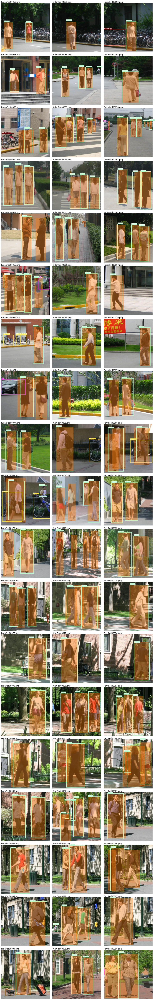

57

In [ ]:
np_images = all_images.cpu().numpy().transpose((0, 2, 3, 1))
plot_images(np_images, all_image_paths,
            det_boxes=all_det_boxes, det_labels=all_det_labels, true_boxes=all_true_boxes,
            max_qty=None, total_width=14, denorm_params=(dataset_mean, dataset_std))

**Примечание:**
- gt-боксы - это оранжевые полупрозрачные проямоугольники (класс везде один, поэтому на картинках не указан)
- все остальные рамки с подписями классов - это предикты


**Итого:**
- правильно найдено 4 неразмеченных объекта (это проблема разметки)
- не найдено 20 размеченных объектов
- характерные черты ненайденных объектов:
    - малый или очень малый размер
    - перекрытие с другим объектом данного класса
    - положение объекта боком или спиной к кадру
    - на `PennPed00071.png` девушка имеет черный цвет кожи
    

Таким образом, в качестве аугментации имеет смысл использовать:
- масштабирование (преимущественно в сторону уменьшения)
- сжатие в горизонтальном направлении
- зеркальное отображение (по горизонтали)
- сдвиги
- небольшие вращения
- изменение цветовой гаммы
- блур, контраст

In [ ]:
# отфильтруем данные для класса 'person'
det_boxes, det_scores, det_map_to_images, true_boxes = filter_for_AP(all_det_boxes,
                                                                     all_det_labels,
                                                                     all_det_scores,
                                                                     all_true_boxes,
                                                                     all_true_labels,
                                                                     target_label=15)

In [ ]:
# разница между количеством gt боксов и количеством найденных объектов данного класса (проверка)
sum(map(len, true_boxes)) - len(det_boxes)

16

### **Задание 4**. (12 баллов) 

А вот теперь будем играться с моноклассовой модификацией детектора.

1. Замените головы нашего `SSD300` так, чтобы теперь он детектировал только один класс. Вы можете создать новый экземпляр класса с другим параметром и аккуратно подтащить веса, либо уже у существующего `pretrained` детектора заменить необходимые слои (2 балла) 

2. Подготовьте код для обучения и тестирования. **Явно пропишите свои функции train_epoch** (3 балла), **evaluate** (2 балла).

Процедуры обучения и эвала можно посмотреть тут: [тык 1](https://github.com/pytorch/vision/blob/master/references/detection/engine.py), [тык 2](https://github.com/multimodallearning/pytorch-mask-rcnn/blob/master/model.py#L1736), [тык 3](https://github.com/pytorch/vision/blob/0467c9d74c9b34f91df905ed8cf8433de48d7fa5/references/detection/coco_eval.py#L19). А ещё можно покопаться в одной из самых известных (но чуть более сложной чем у нас) реализаций [ssd на pytorch](https://github.com/amdegroot/ssd.pytorch). 

3. Поэкспериментируйте и постарайтесь выйти на хорошее качество на test - **bbox AP@IoU=0.75 >=0.95**. Попробуйте разные аугментации, lr, оптимайзеры, заморозку слоев и что ещё хочется (может быть самые смелые даже набор якорей попробуют поменять?). Напишите резюме - что получилсь, что нет, что зашло - а что не оч. (5 баллов)

Какой результат проверки гипотезы? Лучше ли тюнить детектор или и так было норм?

In [ ]:
ssd2 = SSD300(n_classes=2)
ssd2.to(device)


 Loaded backbone.



SSD300(
  (base): VGGBase(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=True)
    (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), 

Подгрузим веса:

In [ ]:
state_dict = ssd2.state_dict()
pretrained_state_dict = checkpoint['state_dict']

# количество классов в старой модели
old_n_classes = 21
# количество классов в новой модели
new_n_classes = 2

# интересующий нас класс в нотации Pascal VOC (старая модель)
old_target_label = 15
# новый идентификатор класса
new_target_label = 1

for param in state_dict.keys():
    if param.find('cl_conv') == -1:
        state_dict[param] = pretrained_state_dict[param]
    else:
        state_dict[param][0::new_n_classes] = pretrained_state_dict[param][0::old_n_classes]
        state_dict[param][new_target_label::new_n_classes] = pretrained_state_dict[param][old_target_label::old_n_classes]

ssd2.load_state_dict(state_dict)

<All keys matched successfully>

Заморозим слои:

In [ ]:
# for param in state_dict.keys():
#     if param.find('pred_conv') == -1:
#         ssd2.get_parameter(param).requires_grad = False

Пишем код для обучения и тестирования

In [ ]:
def train_epoch(model, optimizer, criterion, data_loader, device, learning_rate):
    model.train()
    optimizer.param_groups[0]['lr'] = learning_rate
    
    sum_loss = 0.0
    all_true_boxes = list()
    all_true_labels = list()
    all_locs = list()
    all_scores = list()
    
    for i, data in enumerate(data_loader):
        images, boxes, labels, paths = data
        
        # прогоняем батч через сеть и считаем loss
        images = images.to(device)
        boxes = list(map(lambda x: x.to(device), boxes))
        labels = list(map(lambda x: x.to(device), labels))
        locs, scores = model(images)
        loss = criterion(locs, scores, boxes, labels)

        # зануляем градиенты, считаем новые, обновляем веса
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # обновляем суммарный лосс за эпоху
        sum_loss += loss.item()
        
        # сохраняем данные для дальнейшей фильтрации предиктов и расчета AP
        all_locs.append(locs)
        all_scores.append(scores)
        all_true_boxes.extend(boxes)
        all_true_labels.extend(labels)
    
    # получаем отфильтрованные предикты для всего датасета
    all_locs = torch.cat(all_locs, dim=0)
    all_scores = torch.cat(all_scores, dim=0)
    all_det_boxes, all_det_labels, all_det_scores = model.detect_objects(all_locs, all_scores,
                                                                         min_score, max_overlap, top_k)
    # считаем interpolated AP
    ap, _, _ = calculate_AP(all_det_boxes, all_det_labels, all_det_scores,
                            all_true_boxes, all_true_labels,
                            target_label=1, iou_threshold=iou_threshold,
                            interpolate=True)    

    # считаем средний лосс за эпоху
    mean_loss = sum_loss / (i + 1)
    
    return mean_loss, ap

In [ ]:
def evaluate(model, criterion, data_loader, device):
    model.eval()

    with torch.no_grad():
        sum_loss = 0.0
        all_true_boxes = list()
        all_true_labels = list()
        all_locs = list()
        all_scores = list()
    
        for i, data in enumerate(data_loader):
            images, boxes, labels, paths = data

            # прогоняем батч через сеть и считаем loss
            images = images.to(device)
            boxes = list(map(lambda x: x.to(device), boxes))
            labels = list(map(lambda x: x.to(device), labels))
            locs, scores = model(images)
            loss = criterion(locs, scores, boxes, labels)

            # обновляем суммарный лосс за эпоху
            sum_loss += loss.item()

            # сохраняем данные для дальнейшей фильтрации предиктов и расчета AP
            all_locs.append(locs)
            all_scores.append(scores)
            all_true_boxes.extend(boxes)
            all_true_labels.extend(labels)
        
    
    # получаем отфильтрованные предикты для всего датасета
    all_locs = torch.cat(all_locs, dim=0)
    all_scores = torch.cat(all_scores, dim=0)
    all_det_boxes, all_det_labels, all_det_scores = model.detect_objects(all_locs, all_scores,
                                                                         min_score, max_overlap, top_k)
    # считаем interpolated AP
    ap, _, _ = calculate_AP(all_det_boxes, all_det_labels, all_det_scores,
                            all_true_boxes, all_true_labels,
                            target_label=1, iou_threshold=iou_threshold,
                            interpolate=True)    

    # считаем средний лосс за эпоху
    mean_loss = sum_loss / (i + 1)
    
    return mean_loss, ap

Проверим, что ничего не поломалось:

In [ ]:
# заведем новые тестовый датасет и тестовый даталоадер с учетом того,
# что теперь у нас метка класса равна 1
test_dataset = PedestrianSet(dataset_path, transforms=test_transform, target_label=1, is_train=False)
test_dataloader = DataLoader(test_dataset, batch_size=12, num_workers=0, shuffle=False, collate_fn=collate)

In [ ]:
criterion = MultiBoxLoss(ssd2.priors_cxcy, threshold=0.5, neg_pos_ratio=3, alpha=1.0)

In [ ]:
# Параметры для фильтрации предиктов и оценки качества:
min_score = 0.7
max_overlap = 0.5
top_k = 100
target_label = 1
iou_threshold = 0.75

In [ ]:
test_loss, ap = evaluate(ssd2, criterion, test_dataloader, device)
print(f'test loss = {test_loss:.3f}')
print(f'interpolated AP = {ap:.3f}')

test loss = 1.473
interpolated AP = 0.744


Качество практически такое же как и у старой модели, теперь можно доучивать.

In [ ]:
# определим новые трансформации (с аугментацией) для трейн-датасета
train_transform = tf.Compose(
    [   
        tf.RandomColorJitter(),
        tf.RandomBlur(),
        tf.RandomMirror(p=0.5),
        tf.RandomScale(scale_range=(0.5, 1.2), p=0.5),
        # tf.RandomRotation(angle_range=(-7, 7), p=0.5),
        # tf.RandomAffine(x_range=(-0.05, 0.05), y_range=(-0.05, 0.05), p=0.4),
        tf.Resize(shape=(300, 300)),
        tf.ToTensor(),
        tf.Normalize(mean=dataset_mean, std=dataset_std)
    ])

Протестируем трейн-трансформер

In [ ]:
# заведем вспомогательные датасет и даталоадер для теста трансформаций
check_tf_dataset = PedestrianSet(dataset_path, transforms=train_transform, target_label=15, is_train=False)
check_tf_dataloader = DataLoader(check_tf_dataset, batch_size=12, num_workers=1, shuffle=False, collate_fn=collate)

In [ ]:
# преобразуем все картинки в датасете
all_images = list()
all_true_boxes = list()
all_true_labels = list()
all_image_paths = list()

for images, boxes, labels, paths in check_tf_dataloader:
    all_images.append(images)
    all_true_boxes.extend(boxes)
    all_true_labels.extend(labels)
    all_image_paths.extend(paths)

all_images = torch.cat(all_images, dim=0)

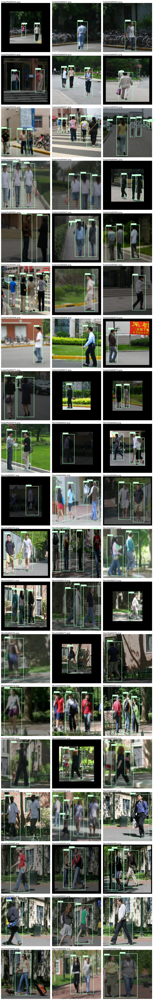

57

In [ ]:
# посмотрим на результат
np_images = all_images.cpu().numpy().transpose((0, 2, 3, 1))
plot_images(np_images, all_image_paths,
            det_boxes=all_true_boxes, det_labels=all_true_labels,
            max_qty=None, total_width=14, denorm_params=(dataset_mean, dataset_std))

Сетка должна страдать, поэтому будем считать, что все неплохо. Двигаемся дальше.

In [ ]:
# Базовые параметры для обучения:
batch_size = 29
num_workers = 1
lr = 3e-4

In [ ]:
# заведем новые трейн датасет и трейн даталоадер с учетом того,
# что теперь у нас метка класса равна 1
train_dataset = PedestrianSet(dataset_path, transforms=train_transform,
                              target_label=1, is_train=True)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size,
                              num_workers=num_workers, shuffle=True, collate_fn=collate)

In [ ]:
num_epochs = 30
optimizer = torch.optim.Adam(filter(lambda p: p.requires_grad, ssd2.parameters()), lr)
lr_schedule = [3e-4] * 10 + [1e-4] * 10 + [3e-5] * 10
result_list = list()

Наконец-то начинаем учить.

In [ ]:
for epoch in range(num_epochs):
    print(f'Epoch: {epoch + 1} / {num_epochs}')
    
    lr = lr_schedule[epoch]

    # training
    t_start = time.time()
    train_loss, train_ap = train_epoch(ssd2, optimizer, criterion, train_dataloader, device, lr)
    train_time_elapsed = time.time() - t_start
    print(f'[Train] Loss: {train_loss:.3f}, AP: {train_ap:.3f}, time_elapsed: {train_time_elapsed:.2f}')
    
    # validation
    t_start = time.time()
    test_loss, test_ap = evaluate(ssd2, criterion, test_dataloader, device)
    test_time_elapsed = time.time() - t_start
    print(f'[Test] Loss: {test_loss:.3f}, AP: {test_ap:.3f}, time_elapsed: {test_time_elapsed:.2f}')
    
    # logging
    result = {'epoch': epoch + 1,
              'lr': lr,
              'train_loss': train_loss,
              'train_ap': train_ap,
              'train_time': train_time_elapsed,
              'test_loss': test_loss,
              'test_ap': test_ap,
              'test_time': test_time_elapsed,
              }

    result_list.append(result)    
    
    print('----------------------')

print('Finished training! Enjoy your results!')

Epoch: 1 / 30
[Train] Loss: 2.893, AP: 0.165, time_elapsed: 12.35
[Test] Loss: 2.907, AP: 0.112, time_elapsed: 3.07
----------------------
Epoch: 2 / 30
[Train] Loss: 2.367, AP: 0.203, time_elapsed: 12.12
[Test] Loss: 1.862, AP: 0.509, time_elapsed: 3.17
----------------------
Epoch: 3 / 30
[Train] Loss: 2.118, AP: 0.316, time_elapsed: 12.64
[Test] Loss: 2.015, AP: 0.329, time_elapsed: 3.16
----------------------
Epoch: 4 / 30
[Train] Loss: 1.982, AP: 0.337, time_elapsed: 12.17
[Test] Loss: 1.652, AP: 0.656, time_elapsed: 3.18
----------------------
Epoch: 5 / 30
[Train] Loss: 1.783, AP: 0.393, time_elapsed: 12.38
[Test] Loss: 1.818, AP: 0.398, time_elapsed: 3.23
----------------------
Epoch: 6 / 30
[Train] Loss: 1.743, AP: 0.489, time_elapsed: 12.57
[Test] Loss: 1.614, AP: 0.613, time_elapsed: 3.15
----------------------
Epoch: 7 / 30
[Train] Loss: 1.586, AP: 0.518, time_elapsed: 12.54
[Test] Loss: 1.569, AP: 0.633, time_elapsed: 3.16
----------------------
Epoch: 8 / 30
[Train] Loss:

In [ ]:
pd.DataFrame(result_list)

,epoch,lr,train_loss,train_ap,train_time,test_loss,test_ap,test_time
0,1,0.00030,2.893051,0.164571,12.345573,2.906722,0.112345,3.071165
1,2,0.00030,2.366921,0.203343,12.119674,1.862368,0.508762,3.169229
2,3,0.00030,2.117872,0.315865,12.637202,2.014708,0.328886,3.156004
3,4,0.00030,1.982316,0.336547,12.165947,1.652207,0.656130,3.184460
4,5,0.00030,1.782895,0.392983,12.378071,1.817516,0.397535,3.231900
5,6,0.00030,1.742629,0.488773,12.570377,1.614143,0.612688,3.150739
6,7,0.00030,1.586195,0.517782,12.544076,1.568835,0.633236,3.157398
7,8,0.00030,1.450987,0.565662,12.538084,1.479387,0.630017,3.175879
8,9,0.00030,1.381841,0.540831,12.479925,1.467565,0.694970,3.203006
9,10,0.00030,1.347776,0.611897,12.181972,1.433142,0.655486,3.197393


**Итоги:**
- Если заморозить все слои, кроме `pred_convs`, то сетка практически не учится.
- Обучение всей сети позволяет получить более высокую AP, но учить сеть тяжело: лосс трейна сильно колеблется. Возможно это связано с отсутствием BatchNorm в нашей сети.
- Сеть не переучивается, значит, трансформации подобраны нормальные.
- В начале обучения сети непросто даются аффинные преобразования (сдвиги) и вращения картинки, но если их включить после 10-ка эпох, то процесс обучения идет ровнее (в текущей версии отключены оба преобразования).
- Вращения реализованы не идеально, но, кажется, сетке понравилось.
- batch_size лучше брать по-больше, тогда лосс скачет в меньшей степени.
- План изменения learning rate подбирался вручную.
- Лучшее качество, которое удавалось получить - AP ~ 0.82.

Таким образом, можно сделать вывод, что тюнинг сети дает положительный результат.